In [1]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import ruptures as rpt
import soundfile as sf
from IPython.display import Audio, display

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
signal, sr = librosa.load("Нимфоманка-Монеточка.mp3")

In [6]:
display(Audio(data=signal, rate=sr))

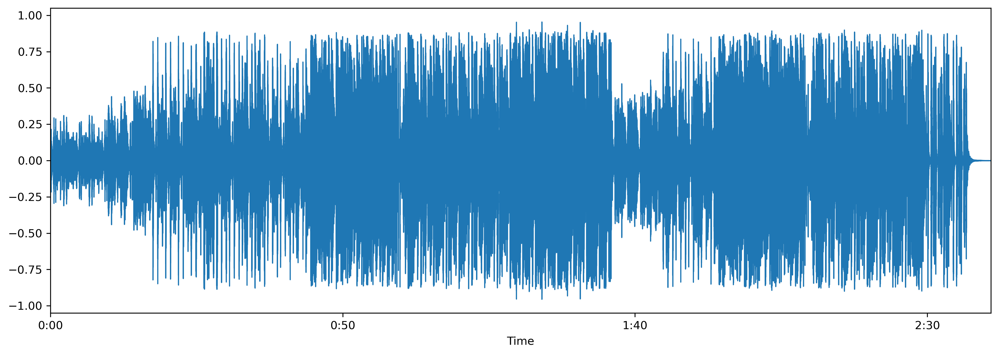

In [7]:
# Visualizing Audio

plt.figure(figsize=(15, 5), dpi=300)
librosa.display.waveplot(signal, sr=sr)

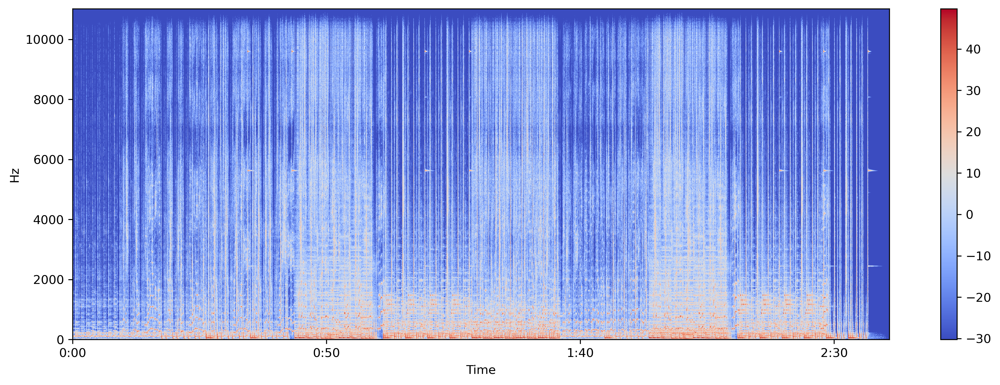

In [8]:
X = librosa.stft(signal)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(15, 5), dpi=300)
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

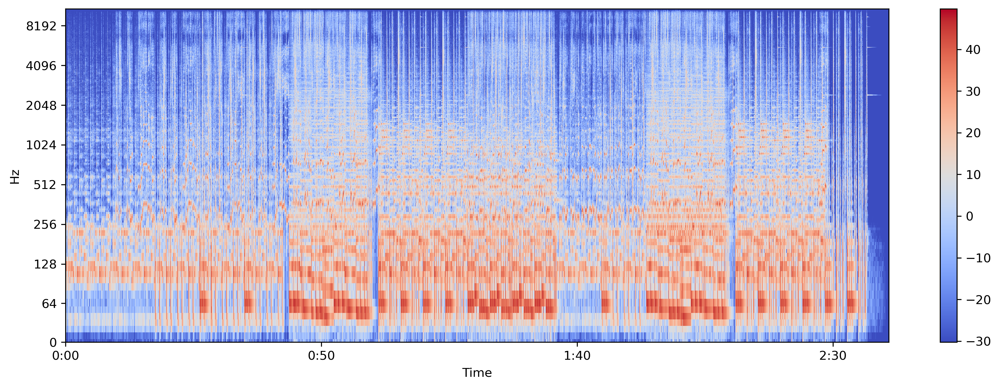

In [9]:
plt.figure(figsize=(15, 5), dpi=300)
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

Text(0.5, 0.9, 'Монеточка - Нимфоманка')

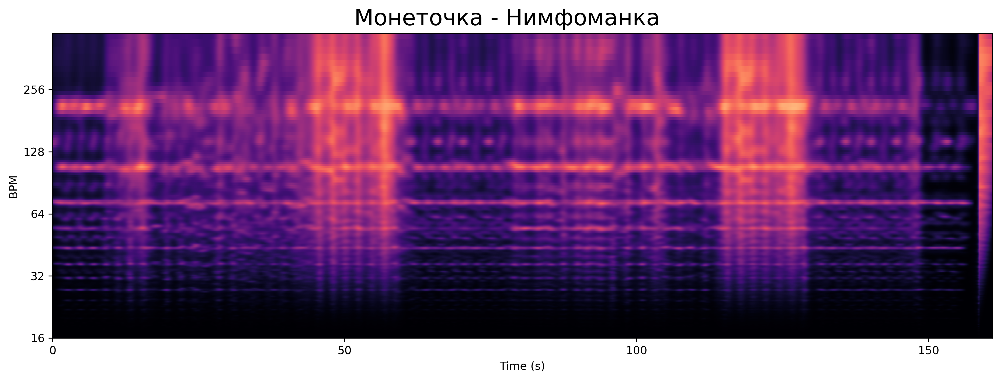

In [10]:
# Tempogram

onset_env = librosa.onset.onset_strength(signal, sr=sr, hop_length=256)

tempogram = librosa.feature.tempogram(onset_envelope=onset_env, sr=sr, 
                                      hop_length=256)

plt.figure(figsize=(15, 5), dpi=300)
librosa.display.specshow(
    tempogram,
    hop_length=256,
    sr=sr,
    x_axis="s",
    y_axis="tempo")
plt.figtext(0.5, 0.9, 'Монеточка - Нимфоманка', fontsize=20, ha='center')

Text(0.5, 0, 'Number of change points')

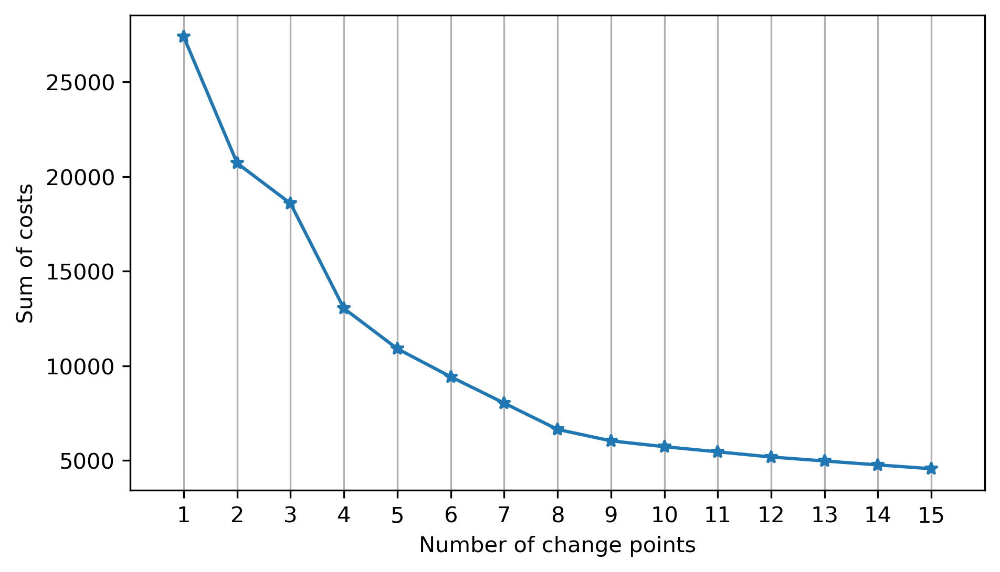

In [11]:
def sum_of_cost(algo_c, n_bkps):
    bkps = algo_c.predict(n_bkps)
    return algo_c.cost.sum_of_costs(bkps)

algo_c = rpt.KernelCPD(kernel="linear").fit(tempogram.T)

n_bkps_max = 15 # Maximal number of changes/segments
algo_c.predict(n_bkps_max)

array_of_n_bkps = np.arange(1, n_bkps_max + 1)

fig, ax = plt.subplots(figsize=(7, 4), dpi=300)
ax.plot(array_of_n_bkps,
    [sum_of_cost(algo_c, n_bkps) for n_bkps in array_of_n_bkps], "-*")
ax.set_xticks(array_of_n_bkps)
ax.grid(axis="x")
ax.set_xlim(0, n_bkps_max + 1)
ax.set_ylabel("Sum of costs")
ax.set_xlabel("Number of change points")

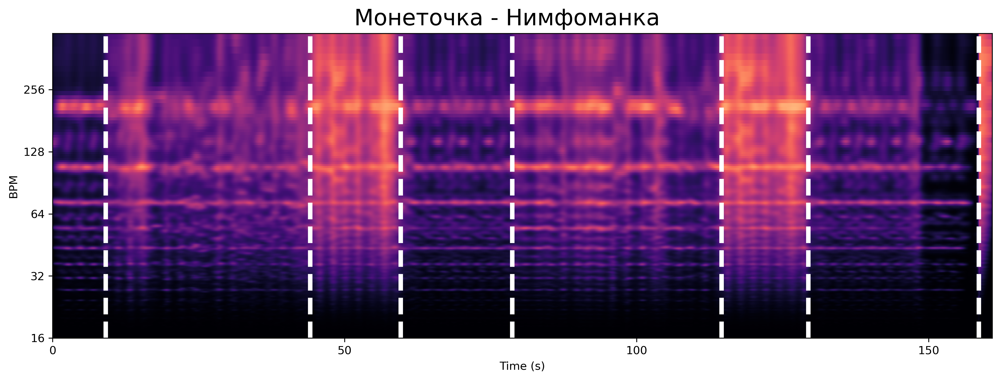

In [12]:
# Based on previously graph and tempogram choose number of change points(bkps=segments-1)

bkps = algo_c.predict(n_bkps=7)
bkps_times = librosa.frames_to_time(bkps, sr=sr, hop_length=256)

# Tempogram with segmentation

fig, ax = plt.subplots(figsize=(15, 5), dpi=300)
librosa.display.specshow(
    tempogram, 
    x_axis="s", 
    y_axis="tempo", 
    hop_length=256, 
    sr=sr)

for b in bkps_times[:-1]:
    ax.axvline(b, ls="--", color="white", lw=4)
plt.figtext(0.5, 0.9, 'Монеточка - Нимфоманка', fontsize=20, ha='center')
plt.savefig("Monetochka.png")

In [13]:
# Audio segmentation

segments_indexes = (sr * bkps_times).astype(int).tolist()

for (segment_number, (start, end)) in enumerate(
    rpt.utils.pairwise([0] + segments_indexes), start=1):
    segment = signal[start:end]
    print(f"Segment №{segment_number}")
    display(Audio(data=segment, rate=sr))

Segment №1


Segment №2


Segment №3


Segment №4


Segment №5


Segment №6


Segment №7


Segment №8


In [14]:
# Save all segments

for (segment_number, (start, end)) in enumerate(
    rpt.utils.pairwise([0] + segments_indexes), start=1):
    segment = signal[start:end]
    sf.write(f'Segment №{segment_number}.wav', segment, sr)